## Question 2 - Forecasting

## 2.1 
In this part, you will asked to build a model to forecast the hourly readings in the
future (next hour). Can you explain why you may want to forecast the gas consumption in the future? Who would find this information valuable? What can you do if
you have a good forecasting model?

### Answer

The usefulness of IoT based systems is in the data that they collect and hence, forecasting the next hourly meter reading for a particular house would be a largely beneficial feature. Let us answer some of the question below.

### Why would we want to forecast the next hours readings and who would find this beneficial?

This is an interesting question and there are multiple reasons why it is beneficial. Firstly, the Gas Company would benefit a lot by having an accurate prediction of the next hours readings. This allows them to regulate the supply of gas based on its predicted demand. This means that at times when less gas needs to be produced, they can relax some of their production at the plants and this will save them a lot of manhours when gas is predicted to be less required. Looking at the bigger picture, this gas data is from just a single region, and the gas company may have multiple residential regions it needs to supply to. This could mean that the gas company could divert a gas supply from a district needing less gas to one that needs more gas in order to balance the output and save on unnecessary production which will lead to wastage.

However, this would not only benefit the gas company but also the public using the gas. It could be possible that in times where the gas consumption required by the housing area is unexpectedly increased, the gas company would have been slow to respond to the fluctuations in the demand since it was providing only a constant amount regardless of the consumption. With the prediction model, we will be able to predict these seasonal fluctuations with a greater probability and hence save situations in which high demand is not able to be met. This is beneficial for the residents as it ensures a greater user experience and satisfaction which would lead to a positive feedback to the Gas Companies' sales.

### What can we do if we have a good forecasting model?

An IoT system's data is valuable since it can be used to create a good forecasting model. Once this model is proven to work with a high accuracy, a "gas as a service" type product can be given to the users (perhaps at a small price) where the Gas Company could provide the users with visualizations of their predicted usage, ways to reduce their usage and also their past trends all on their mobile phones. This would be a sort of attempt to communicate with the users and to raise awareness to consume less gas by giving them a predicted value. A good forecasting model may not help only with customer satisfaction, it can easily help the company itself plan ahead their factory loads and aid them to better plan their production resources and timelines, greatly affecting the scalability and efficiency of their business.

With a reliable forecasting model, companies can better detect anomalies and discover any deviations which would allow them to easily investigate the underlying factors. For example, an abnormally high reading outside the confidence interval of our model could indicate a gas leak present at the household.

Net, this forecasting model is a very lucrative resource for the Gas Company to have as it aids in customer satisfaction and their productivity. 

## Building the Forecasting Model

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime as dt
from datetime import datetime,timedelta
import numpy as np
from functools import reduce
from sklearn.metrics import mean_squared_error as mse
from tqdm.auto import tqdm
from tqdm import tqdm
from copy import deepcopy

from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

plt.rcParams.update({'figure.max_open_warning': 0})

pd.options.mode.chained_assignment = None  # default='warn'
pd.set_option('display.max_rows', 157)

We modified the csv to include more features which we believe can improve the accuracy of our model in predicting the hourly forecasted gas consumption by performing some preprocessing. We noticed a non-linear trend in most households and decided to create new features from the localminute field provided, such as the day of the week, or whether it was a holiday or weekday/weekend. We have saved the dataset with the additional features in a csv along with the jupyter notebook. We have also included this csv in the zip submission for you to take a look. 

In [2]:
df = pd.read_csv('Question_2_dataset.csv', index_col='localminute', parse_dates=True, date_parser=lambda col: pd.to_datetime(col, utc=True))
df

,dataid,meter_value,hours_passed,weekday,is_holiday,is_weekday,is_office_hour,is_sleeping,month,year,date,hour
localminute,,,,,,,,,,,,
2015-10-01 05:00:00+00:00,739.0,88858.000000,0,3,0,1,0,1,10,2015,1,5
2015-10-01 06:00:00+00:00,739.0,88858.000000,1,3,0,1,0,1,10,2015,1,6
2015-10-01 07:00:00+00:00,739.0,88860.000000,2,3,0,1,0,1,10,2015,1,7
2015-10-01 08:00:00+00:00,739.0,88860.000000,3,3,0,1,0,1,10,2015,1,8
2015-10-01 09:00:00+00:00,739.0,88860.000000,4,3,0,1,1,1,10,2015,1,9
...,...,...,...,...,...,...,...,...,...,...,...,...
2016-03-08 12:00:00+00:00,4874.0,314452.311622,779,1,0,1,1,0,3,2016,8,12
2016-03-08 13:00:00+00:00,4874.0,314461.233716,780,1,0,1,1,0,3,2016,8,13
2016-03-08 14:00:00+00:00,4874.0,314470.155811,781,1,0,1,1,0,3,2016,8,14


In [3]:
unique_households = df['dataid'].unique()
unique_households.sort()

`plot_overall_timeseries` creates a timeseries plot with the actual meter values we used for training(denoted in blue), the actual meter values we used for testing (denoted in red) as well as the predicted meter values we derived from our model (denoted in orange). In each plot, we also calculated the Mean Squared Error derived from the entire dataset for that particular household, and noted it down in the title of each plot. 

`plot_testing_scatter` creates a scatter plot with the actual meter values we used for testing versus the predicted meter values we derived from our model (denoted in red) as well as the line for goodness of fit that indicates a perfect prediction (denoted in green). In each plot, we also calculated the Mean Squared Error derived from the testing dataset for that particular household, and noted it down in the title of each plot. 


`plot_lr_vs_svr_scatter` creates a scatter plot with the line for goodness of fit that indicates a perfect prediction (denoted in red) as well as the actual versus predicted meter values we derived from the Linear Regression Model, Support Vector Regression Model as well as the ensemble method (denoted in green, orange, and black respectively).

`train_each_house` takes in a string model which creates the respective model and trains the model for each individual household based on the features provided. After training, the plots for each household is displayed over their respective time period. We used the 3 features below as we observed a non-linear trend in the meter value for most households. We incorporated a boolean variable denoting if the particular day is a holiday and another boolean variable denoting if the particular day is a weekday. Our rationale is that households are likely to be at home if it is a weekend or possibly a holiday whereas most people would not be at home during working hours on a weekday. For our training, we took the month of January as the dataset. We used the first 26 days of January as the training dataset and the last 5 days to test the model. We observed that this smaller dataset provided a higher level of accuracy compared to training on the overall dataset. This is because we wanted to predict the next hours' consumption and including datapoints from older consumptions led to more noise during training. Hence the gas company should predict the hourly readings using more relevant readings from a month ago till now.  

`note`: There are two houses names 4874 and 8967 which have incomplete data for this time period and hence we do not include them in our plots. Removing these two from the unique_households is done below.

In [4]:
unique_households = np.delete(unique_households, [83,140])
unique_households

array([  35.,   44.,   77.,   94.,  114.,  187.,  222.,  252.,  370.,
        483.,  484.,  661.,  739.,  744.,  871., 1042., 1086., 1103.,
       1185., 1283., 1403., 1415., 1507., 1556., 1589., 1619., 1697.,
       1714., 1718., 1790., 1791., 1792., 1800., 1801., 2018., 2034.,
       2072., 2094., 2129., 2233., 2335., 2378., 2449., 2461., 2470.,
       2575., 2638., 2645., 2755., 2814., 2818., 2945., 2946., 2965.,
       2980., 3036., 3039., 3134., 3310., 3367., 3527., 3544., 3577.,
       3635., 3723., 3778., 3849., 3893., 3918., 4029., 4031., 4193.,
       4228., 4296., 4352., 4356., 4373., 4421., 4447., 4514., 4671.,
       4732., 4767., 4998., 5129., 5131., 5193., 5275., 5317., 5395.,
       5403., 5439., 5484., 5545., 5636., 5658., 5785., 5810., 5814.,
       5892., 5972., 6101., 6412., 6505., 6578., 6673., 6685., 6830.,
       6836., 6863., 6910., 7016., 7017., 7030., 7117., 7287., 7429.,
       7460., 7566., 7674., 7682., 7739., 7741., 7794., 7900., 7919.,
       7965., 7989.,

In [5]:
features = ['is_holiday', 'is_weekday', 'hours_passed']
hours_to_predict = 120
def plot_overall_timeseries(house_df, train_df, test_df, house):
    mean_squared_error = mse(house_df['predicted_meter_value'], house_df['meter_value'])
    
    plt.figure(figsize=(12, 8))
    plt.scatter(train_df['localminute'], train_df['meter_value'], c='blue',  label = 'actual training value')
    plt.scatter(test_df['localminute'], test_df['meter_value'], c='red' ,  label = 'actual test value')
    plt.scatter(test_df['localminute'], test_df['predicted_meter_value'], c='orange' ,  label = 'predicted test value')
    plt.xlabel('Date')
    plt.ylabel('Gas Consumption')
    plt.title(f'Time Series Plot - Household {house} Overall MSE : {mean_squared_error}')
    plt.legend()
    return plt

def plot_testing_scatter(test_df, house):
    mean_squared_error = mse(test_df['predicted_meter_value'], test_df['meter_value'])
    plt.figure(figsize=(12, 8))
    plt.plot(test_df['meter_value'], test_df['predicted_meter_value'], 'o' ,c='red' ,label = 'scatter of actual vs predicted')
    plt.plot(test_df['meter_value'], test_df['meter_value'], c='green', label = 'line for goodness of fit', linewidth=3)
    plt.xlabel('Actual Meter Value')
    plt.ylabel('Predicted Meter Value')
    plt.title(f' Scatter Plot - Household {house} Testing MSE : {mean_squared_error}')
    plt.legend()
    return plt
    
def plot_lr_vs_svr_line(test_df, house):
    mean_lr_squared_error = mse(test_df['predicted_lr_meter_value'], test_df['meter_value'])
    mean_svr_squared_error = mse(test_df['predicted_svr_meter_value'], test_df['meter_value'])
    true_mean_squared_error = mse(test_df['mean_predicted_meter_value'], test_df['meter_value'])
    plt.figure(figsize=(12, 8))
    plt.plot(test_df['meter_value'], test_df['meter_value'], c='red' ,label = 'line for goodness of fit', linewidth=3)
    plt.plot(test_df['meter_value'], test_df['predicted_svr_meter_value'], '+' , c='orange' ,  label = 'predicted svr test value', linewidth=3)
    plt.plot(test_df['meter_value'], test_df['predicted_lr_meter_value'], '+' , c='green' ,  label = 'predicted lr test value', linewidth=3)
    plt.plot(test_df['meter_value'], test_df['mean_predicted_meter_value'], 'o' , c='black' ,  label = 'predicted mean test value', linewidth=3)
    plt.xlabel('Actual Meter Value')
    plt.ylabel('Predicted Meter Value')
    plt.title(f'Household {house} \nTesting SVR MSE : {mean_svr_squared_error}\nTesting LR MSE : {mean_lr_squared_error}\nEnsemble MSE : {true_mean_squared_error}')
    plt.legend()
    return plt

def train_each_house(model, hours_to_predict):
    def get_mean(row):
        return (row['predicted_svr_meter_value'] + row['predicted_lr_meter_value']) / 2
    
    for house in unique_households:
        house_df = df.loc[df['dataid'] == house]
        house_df = house_df.reset_index()
        # we simply interpolate the hours with no data since meter_value is the cumulative usage.
        house_df = house_df[(house_df['localminute'] > "2016-01-01 00:00:00+00:00") & (house_df['localminute'] < "2016-01-31 23:00:00+00:00")]
        hourly_df_train = house_df[:-hours_to_predict]
        hourly_df_test = house_df[-hours_to_predict:]
        if model == "svr":
            temp_model = make_pipeline(StandardScaler(), SVR(kernel='linear', C=100, gamma=0.1, epsilon=.1))
            temp_model.fit(hourly_df_train[features], hourly_df_train['meter_value'])
        elif model == 'lr' :
            temp_model = make_pipeline(StandardScaler(), LinearRegression())
            temp_model.fit(hourly_df_train[features], hourly_df_train['meter_value'])
        else :
            svr_model = make_pipeline(StandardScaler(), SVR(kernel='linear', C=100, gamma=0.1, epsilon=.1))
            svr_model.fit(hourly_df_train[features], hourly_df_train['meter_value'])
            lr_model = make_pipeline(StandardScaler(), LinearRegression())
            lr_model.fit(hourly_df_train[features], hourly_df_train['meter_value'])
        if model == 'svr' or model == 'lr':
            hourly_df_train['predicted_meter_value'] = temp_model.predict(hourly_df_train[features])
            hourly_df_test['predicted_meter_value'] = temp_model.predict(hourly_df_test[features])
            house_df['predicted_meter_value'] = temp_model.predict(house_df[features])
            plot1 = plot_overall_timeseries(house_df, hourly_df_train, hourly_df_test, house)
            plot2 = plot_testing_scatter(hourly_df_test, house)
        else :
            hourly_df_test['predicted_svr_meter_value'] = svr_model.predict(hourly_df_test[features])
            hourly_df_test['predicted_lr_meter_value'] = lr_model.predict(hourly_df_test[features])
            hourly_df_test['mean_predicted_meter_value'] = hourly_df_test.apply(lambda row : get_mean(row), axis=1)
            plot = plot_lr_vs_svr_line(hourly_df_test, house)
        plt.show()


## 2.2 - Linear Regression

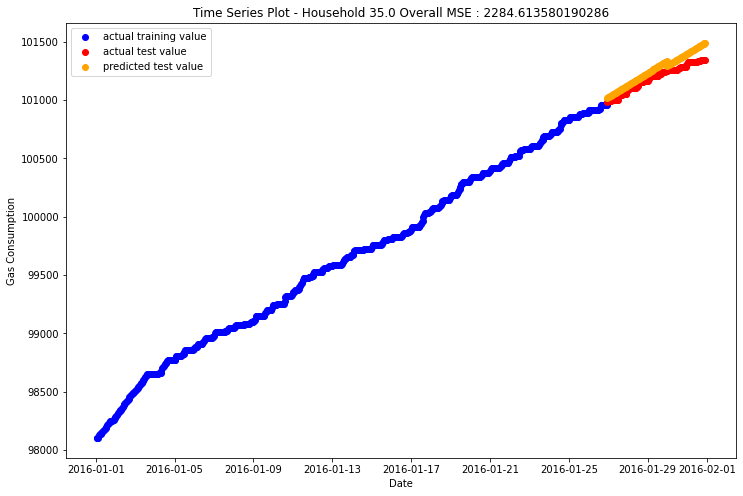

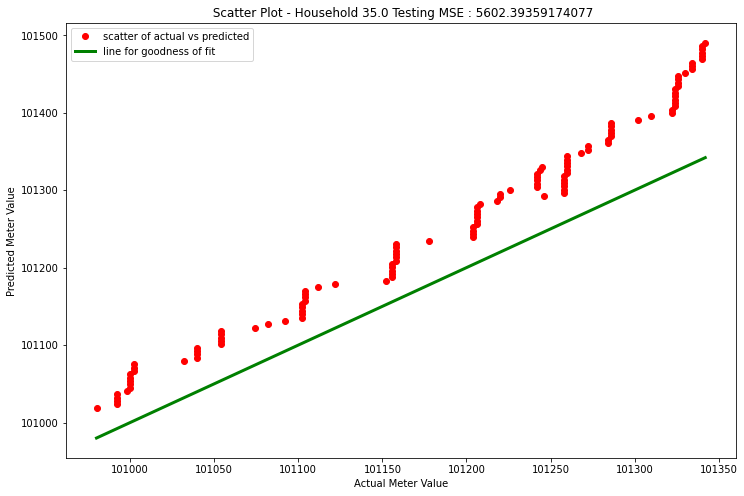

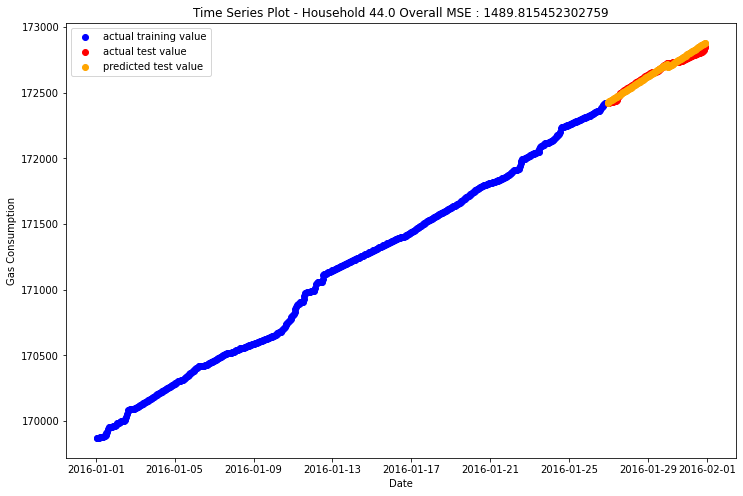

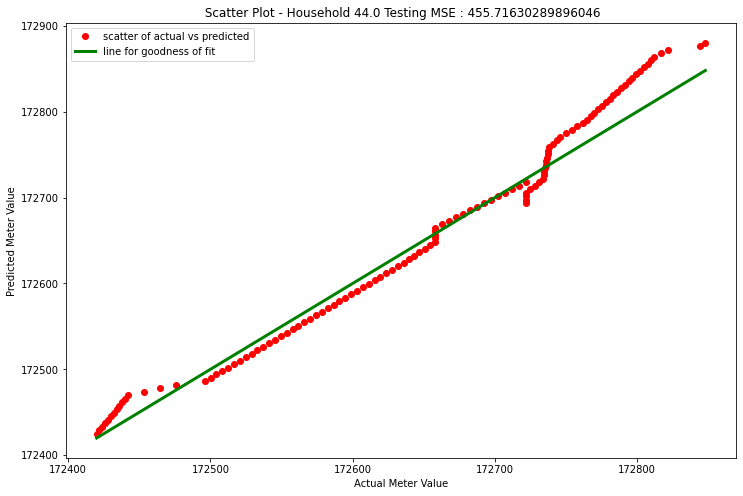

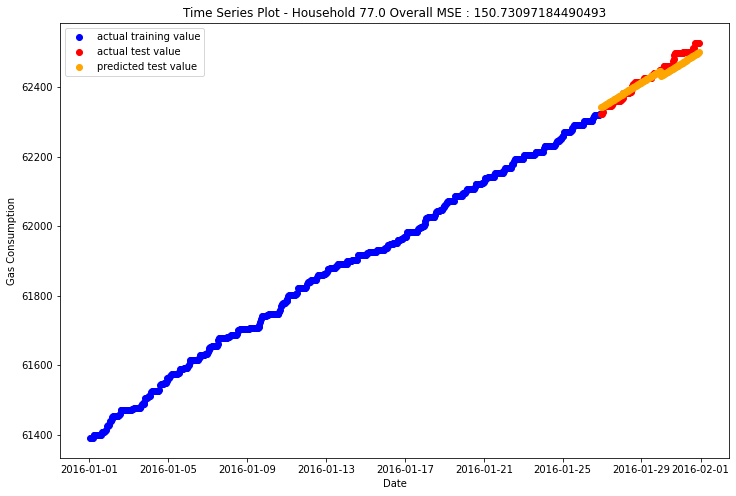

...

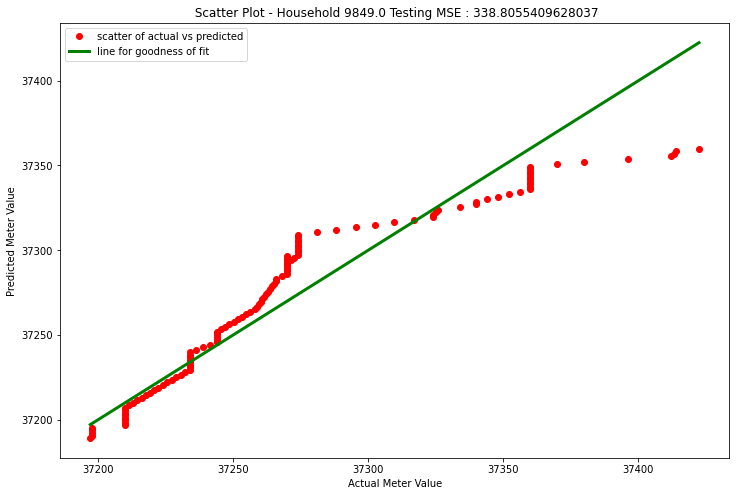

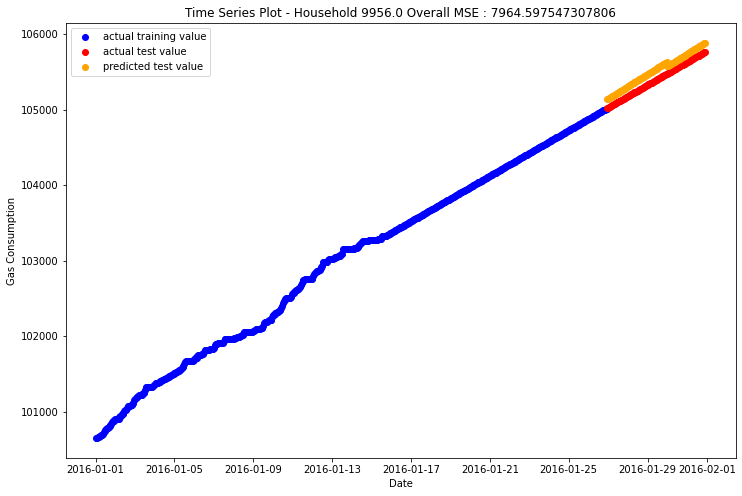

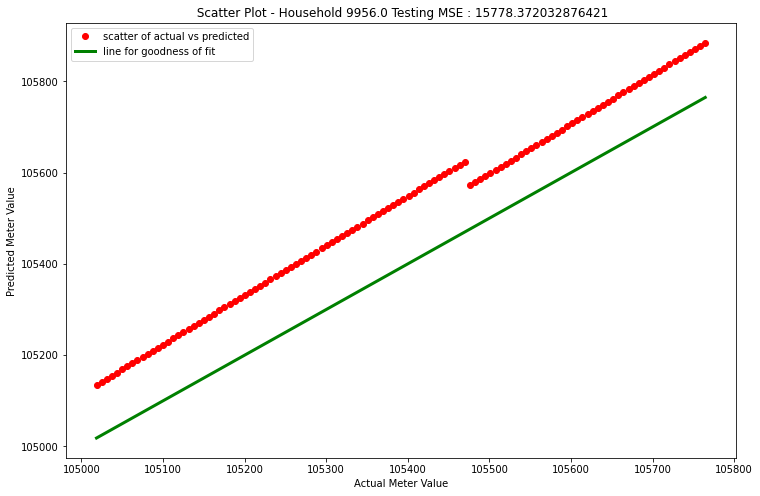

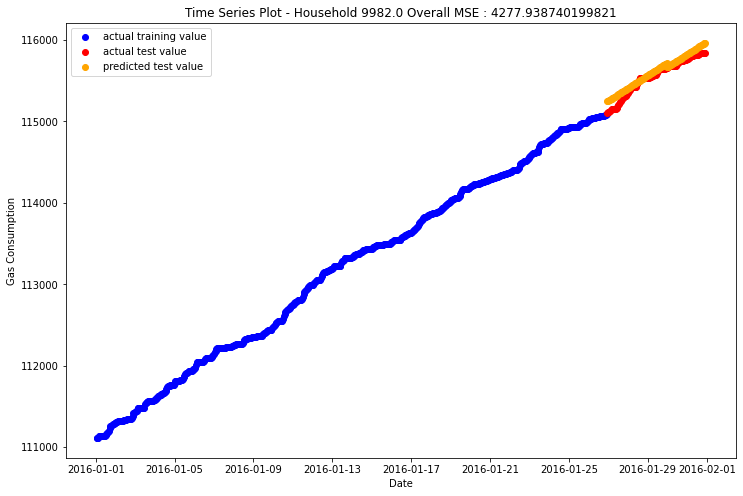

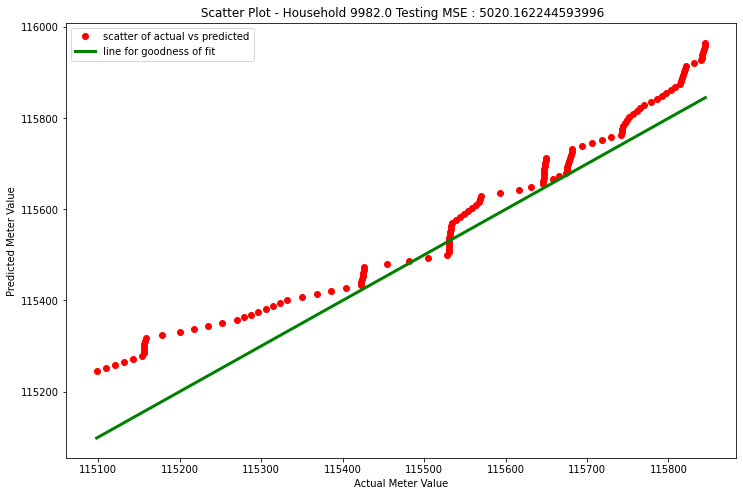

In [6]:
train_each_house("lr", hours_to_predict)

Note that in the above scatter plot for the linear regression model and the below scatter plot for the support vector regression, the line for goodness of fit (denoted in green) is a 45 degree straight line that indicates a perfect prediction.

## 2.3 - SVR 

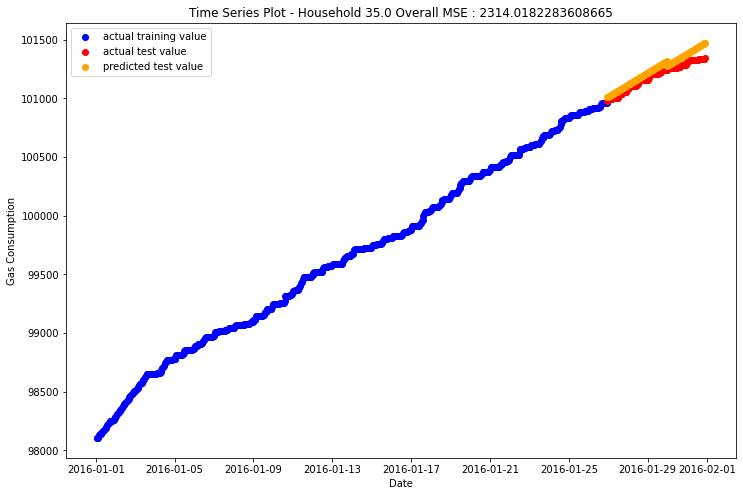

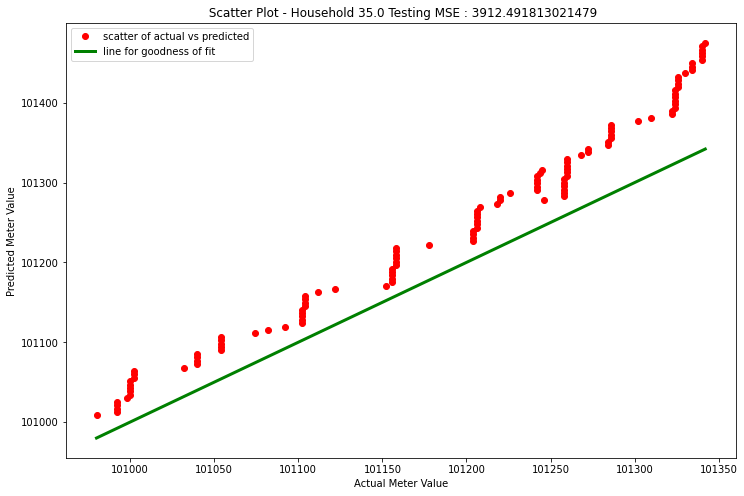

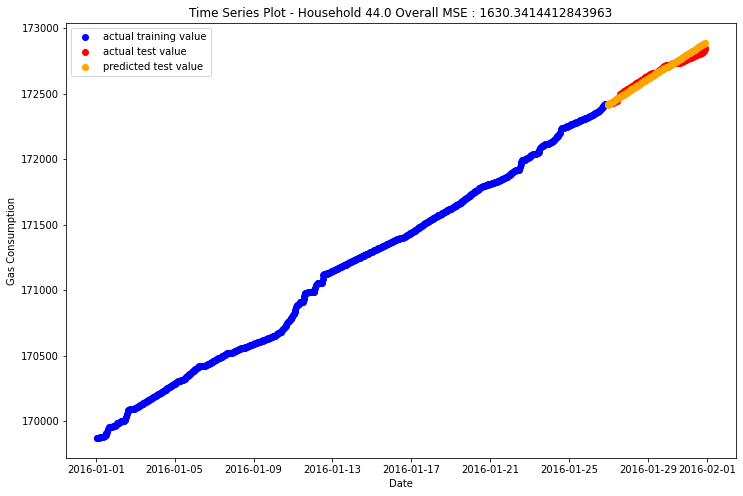

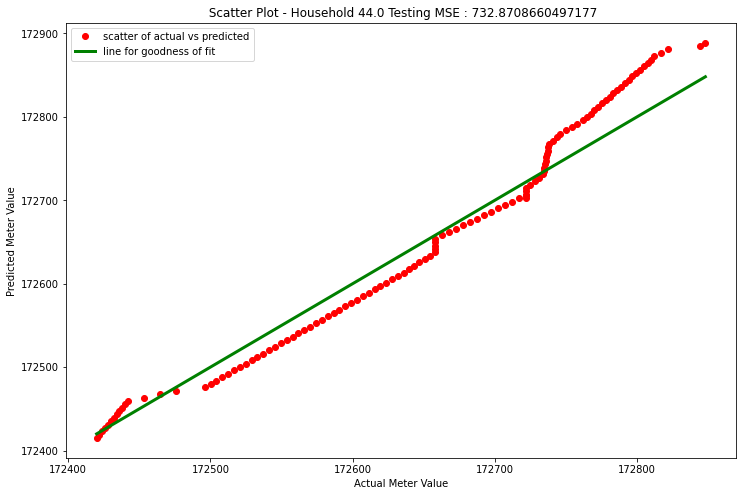

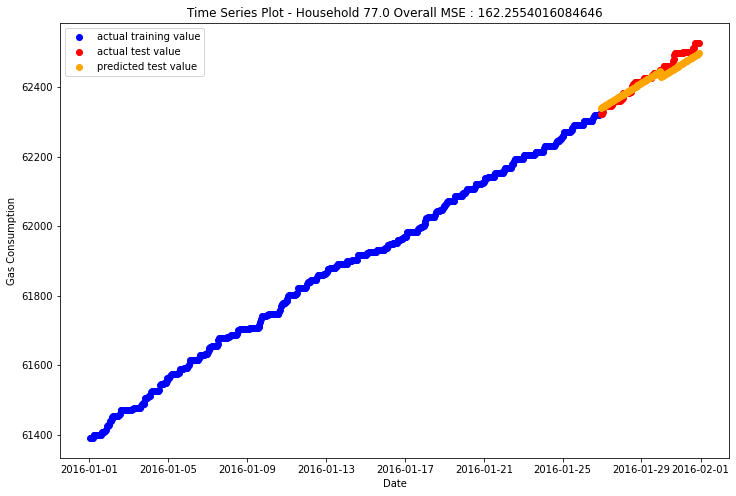

...

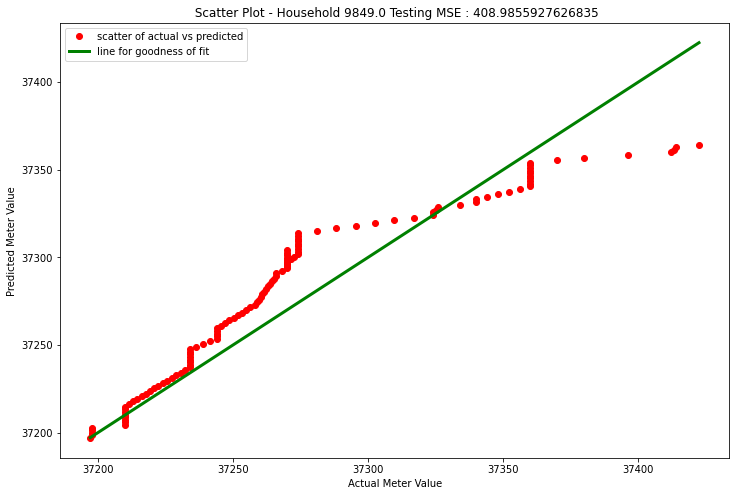

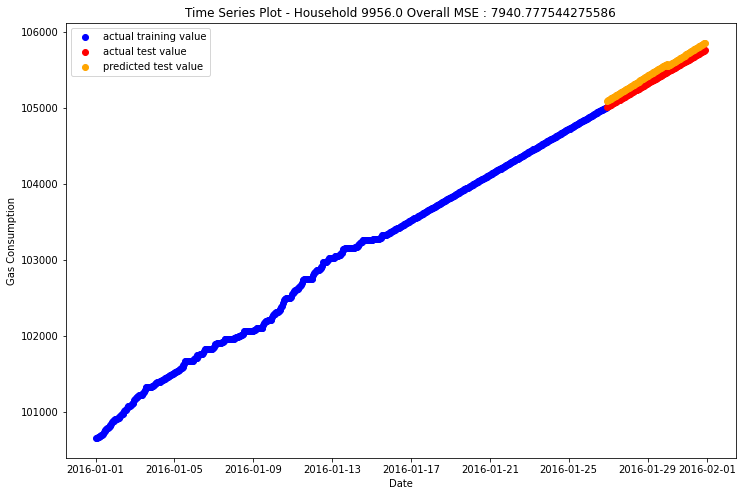

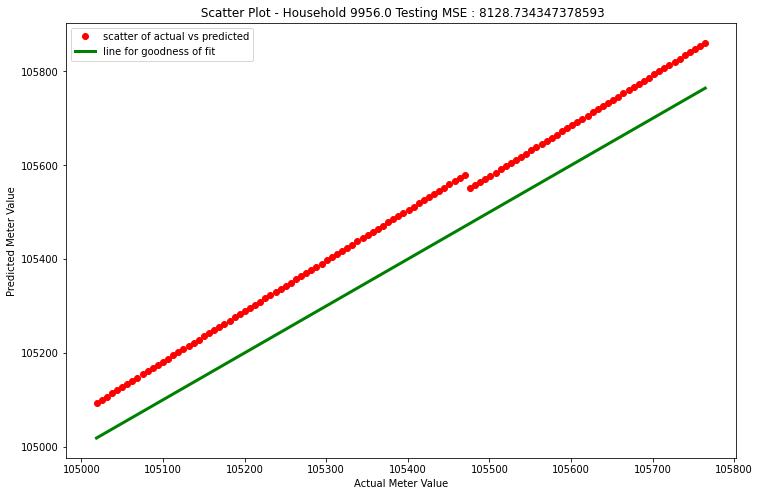

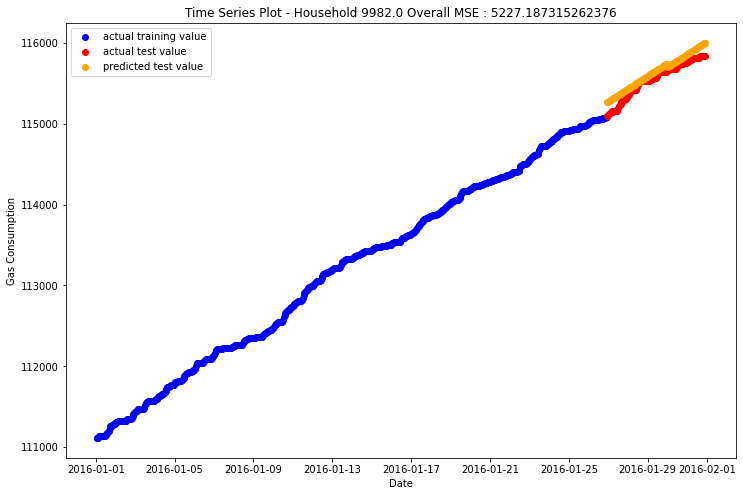

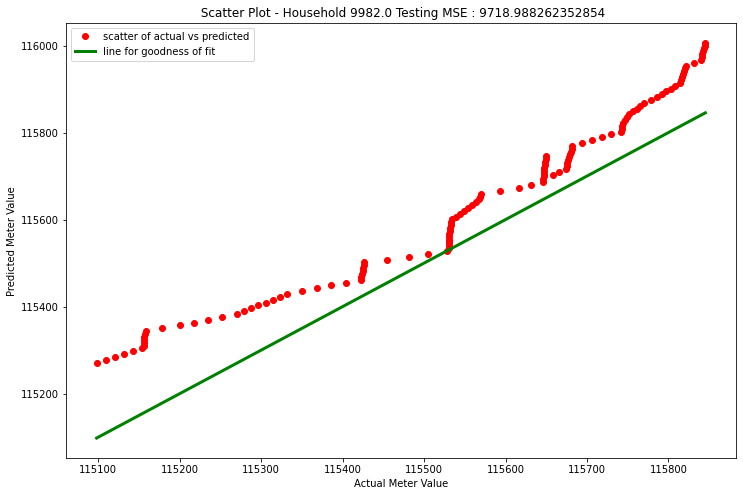

In [7]:
train_each_house("svr", hours_to_predict)


Based on the plots below, we have concluded that there is no meaningful difference between Linear Regression and Support Vector Regression. There are occasions where the LR model performs better than the SVR model and there are also occasions where the SVR model outperforms the LR model. Our team tried using an ensemble method by combining the predictions of both the LR model as well as the SVR model to get better overall performances by reducing the variation in both of them.

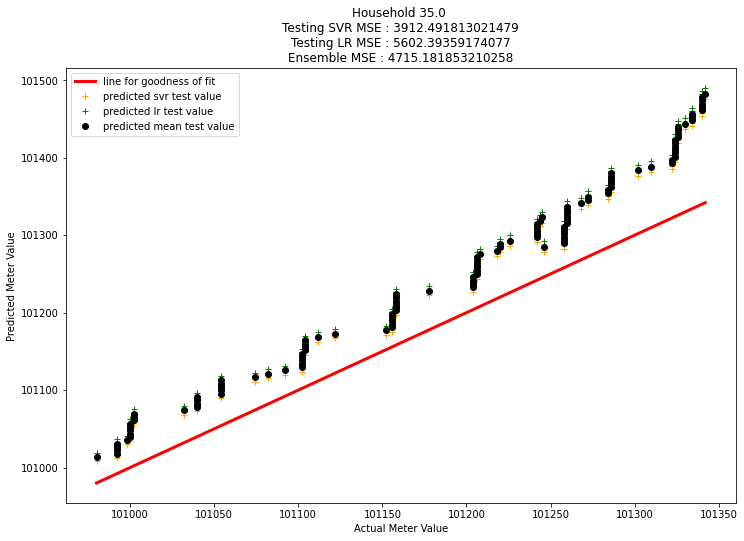

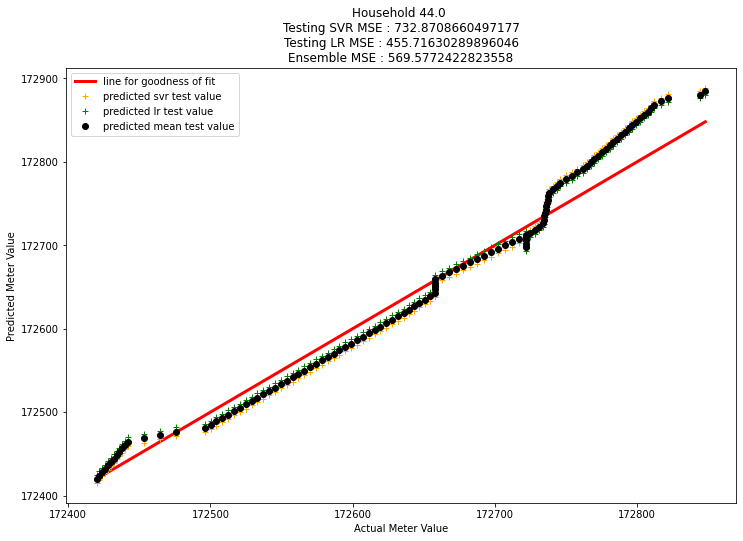

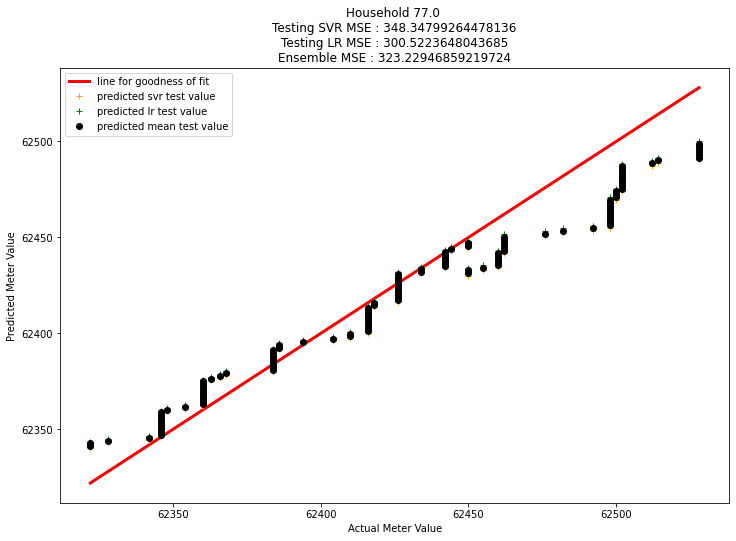

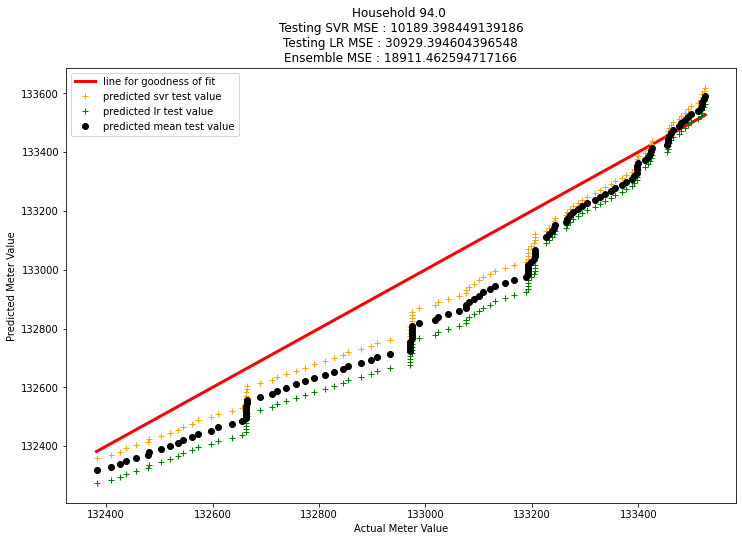

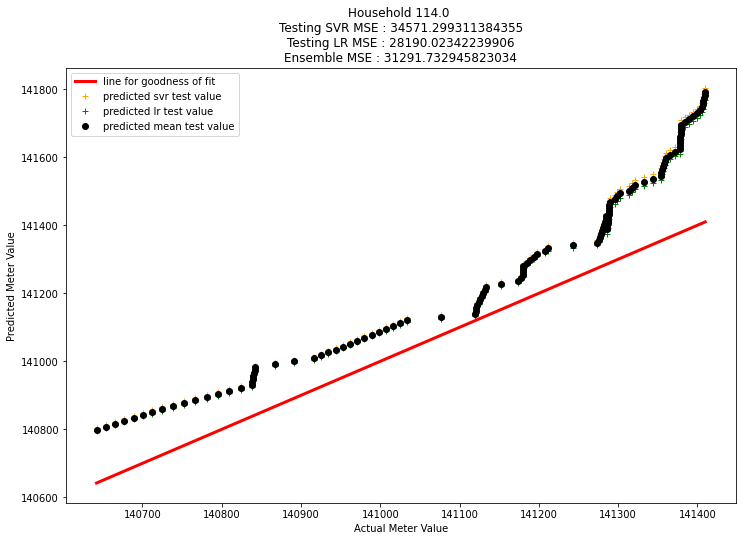

...

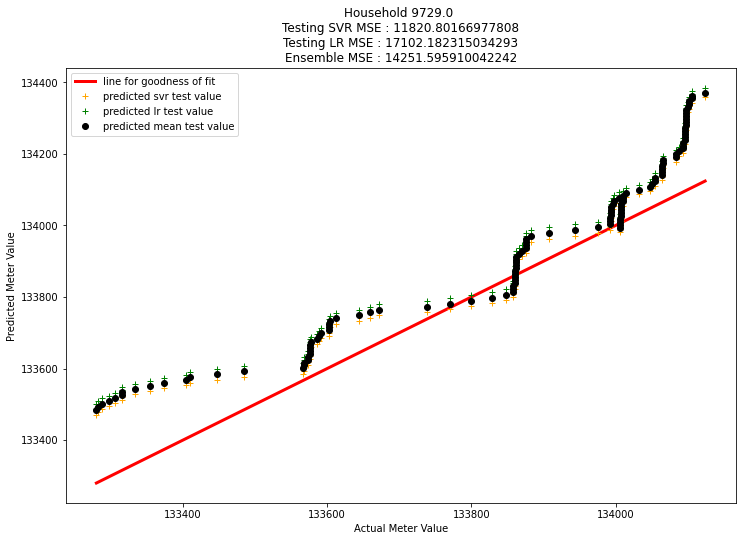

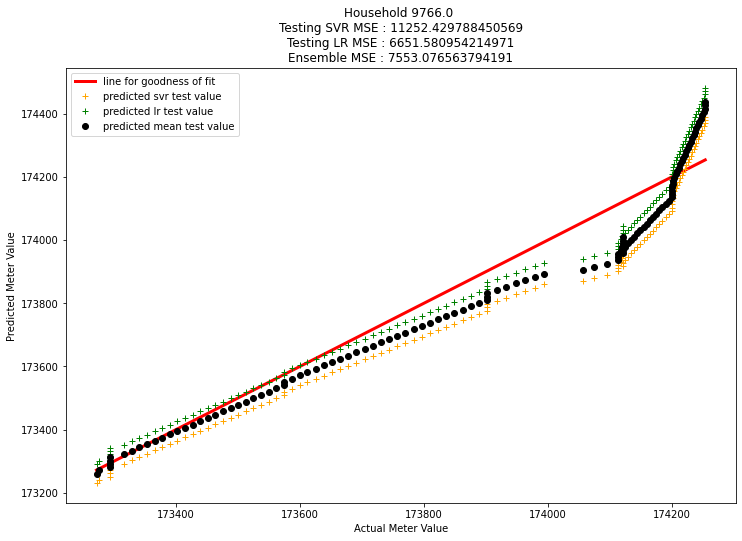

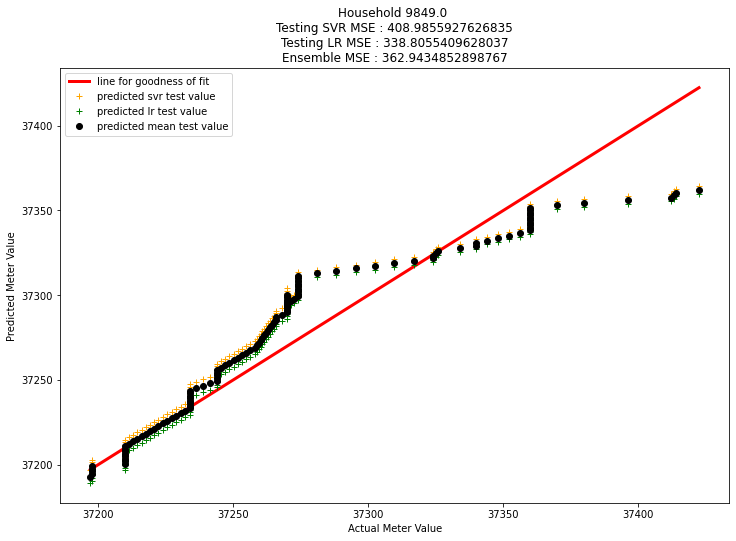

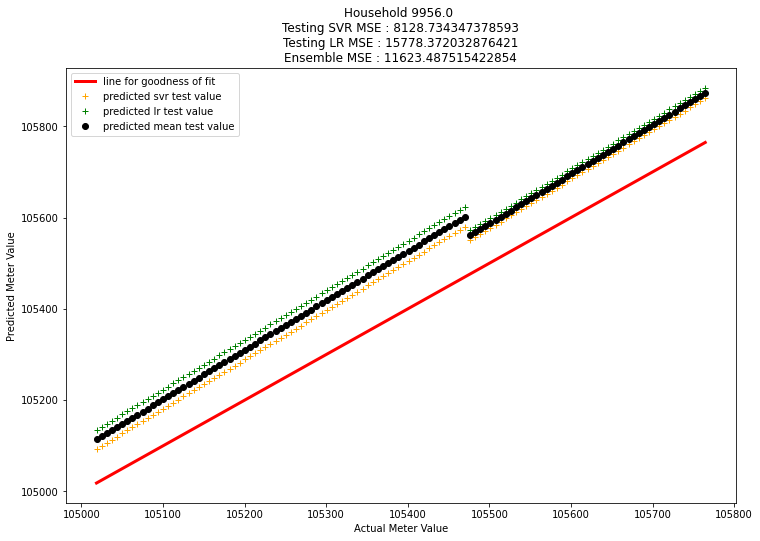

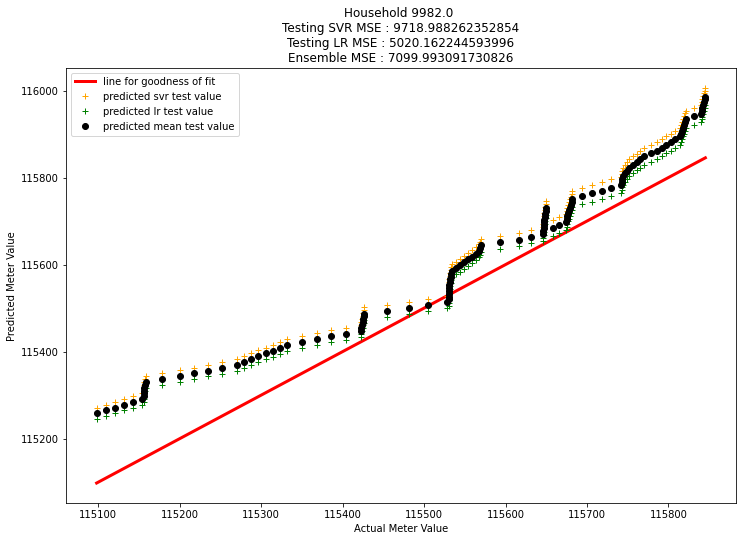

In [8]:
train_each_house("both", hours_to_predict)

Note that in the above diagram, the line for goodness of fit (denoted in red) is a 45 degree straight line that indicates a perfect prediction. 